In [1]:
import os
import tqdm
import pathlib
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_percentage_error
from catboost import CatBoostRegressor
import pandas_profiling
from matplotlib import pyplot as plt
import seaborn as sns

tqdm.tqdm.pandas()
pd.set_option('display.max_columns', None)

C:\ana\lib\site-packages\numba\core\decorators.py:262: NumbaDeprecationWarning: numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.
  warnings.warn(msg, NumbaDeprecationWarning)
C:\ana\lib\site-packages\visions\backends\shared\nan_handling.py:51: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def hasna(x: np.ndarray) -> bool:
C:\Users\Алексей\AppData\Local\Temp\ipykernel_4492\1429300933.py:11: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profi

In [2]:
plt.style.use("bmh")
plt.rcParams["axes.titlesize"] = "large"

In [3]:
%pylab inline

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [4]:
DATA_DIR = pathlib.Path("wow/hakaton/")
RS = 3985

# Загрузка данных

Данные хранятся в формате Parquet: читается быстрее, места занимает меньше.

In [5]:
train = pd.read_parquet("train.parquet")
train

,feature0,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13,feature14,feature15,feature16,feature17,feature18,feature19,feature20,feature21,feature22,feature23,feature24,target0,target1
0,32.910908,17.376350,77.557840,2.929855,gas1,20.487150,57.633085,49.245392,-44.124381,23.400064,-28.640648,-10.995420,40.856313,29.912800,33.168114,18.769718,41.812507,14.203652,9.689942,17.951627,24.198589,102.448710,110.529868,56.817260,12.887802,27.050891,6.502743
1,41.263782,22.419445,47.945514,-25.847472,gas2,21.461239,3.474080,49.659980,-13.553188,-13.047593,-12.445940,16.657368,42.453280,99.792375,127.159321,-13.180244,50.722470,-14.451904,-0.906120,105.724742,-9.435222,-16.060150,37.286110,61.224272,39.822424,84.127890,76.578716
2,25.580283,17.376350,77.654180,2.799411,gas1,20.487150,28.938295,49.245392,-44.124381,20.610679,-28.641150,-1.886830,40.927941,16.340674,60.760647,18.658501,52.731646,14.395054,9.779019,17.951638,24.999453,101.728213,111.471534,52.664304,12.887802,22.080133,3.036043
3,33.756900,17.376350,73.049625,2.953982,gas1,20.487150,28.932311,49.245392,-44.124381,18.107963,-28.642094,16.284415,40.869406,43.707663,48.037510,18.771030,52.305692,14.184314,9.798969,17.951675,23.990300,101.312113,115.589451,56.840719,12.887802,30.234082,8.910795
4,4.223732,38.772534,48.015553,-25.843943,gas2,24.635721,12.011581,51.030938,84.244199,-17.735680,40.395582,16.557978,65.988300,91.081310,150.949700,-13.172169,51.012294,-14.439953,8.262354,90.187207,-2.901661,-16.060150,37.398779,40.488468,128.295838,71.128092,50.475082
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153412,25.851721,17.376350,69.777513,3.086227,gas1,20.487150,9.187947,49.245392,-44.124381,8.395057,-28.641157,25.687912,40.874155,30.217753,60.629469,18.846511,74.241020,14.248014,9.806796,17.951871,24.302496,101.668459,119.189777,52.544704,12.887802,26.319008,4.318349
153413,33.211644,17.376350,84.113483,2.963000,gas1,20.487150,37.677592,49.245392,-44.124381,6.252886,-28.641255,99.694891,40.855835,29.957800,59.524126,18.828185,42.093082,14.351076,9.848909,17.951828,24.122972,101.455016,103.624989,56.818116,12.887802,19.951185,7.128586
153414,0.339018,17.376350,77.627839,2.889655,gas1,20.487150,49.094915,49.245392,-44.124381,23.596678,-28.640526,25.816561,40.866704,43.946905,60.819833,19.073488,85.380269,14.402462,9.798969,17.951898,16.179377,101.198059,110.992570,39.673505,12.887802,28.492906,5.589999
153415,21.018093,38.902218,48.015239,-25.843954,gas2,24.642608,0.626815,51.022655,84.812493,-30.045713,40.703237,-1.855328,65.997626,88.992559,126.985525,-13.172113,72.374653,-14.439792,8.337519,89.157475,-2.915824,-16.060150,37.399312,50.917348,128.621094,72.065991,51.306816


In [6]:
pandas_profiling.ProfileReport(train) 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

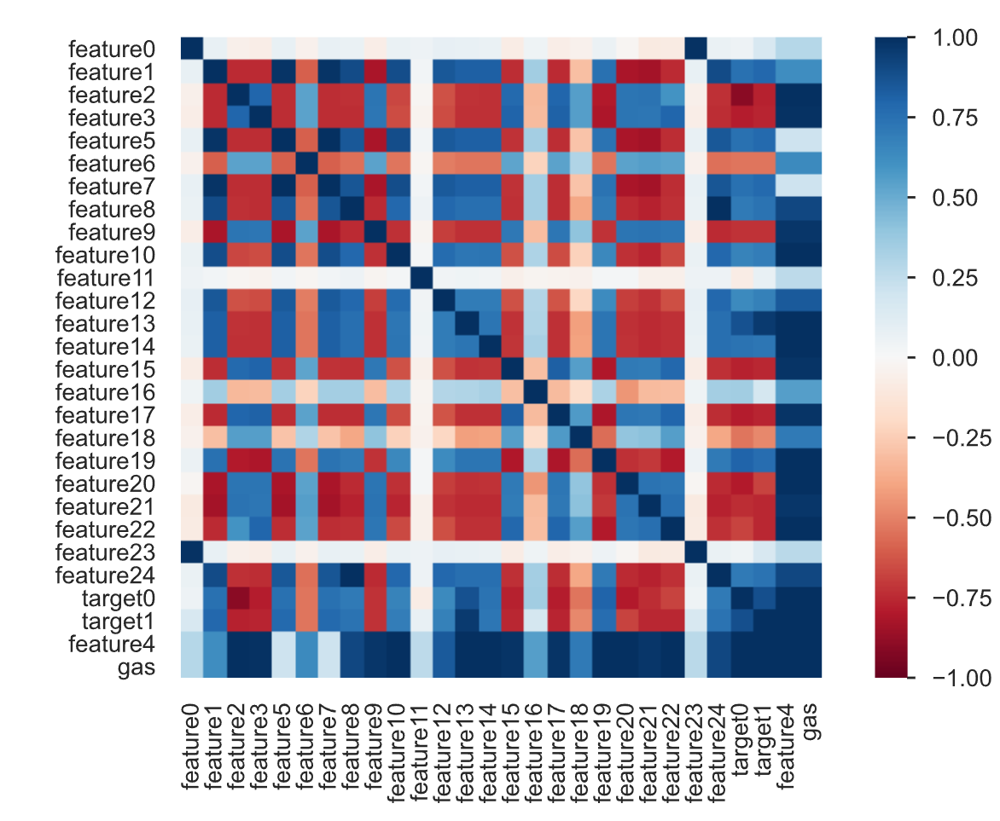

In [7]:
CAT = ["feature4"]
TARGETS = ["target0", "target1"]
FTS = train.filter(like="feature").columns.difference(CAT)

Проверяем, что с пропусками:

In [8]:
train.isnull().any().mean()

0.0

Их нет! Вот это поворот! Посмотрим на таргеты:

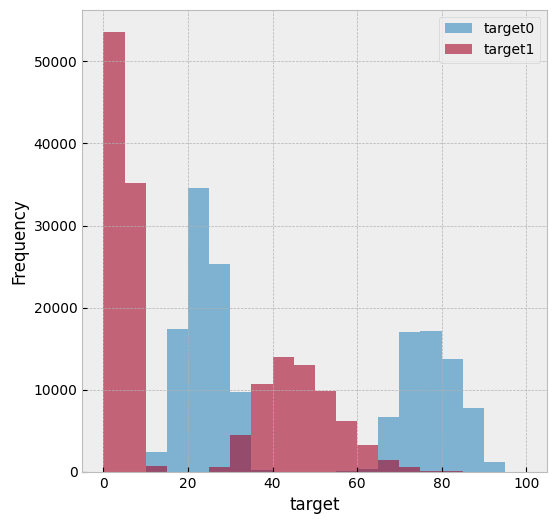

In [9]:
plt.figure(figsize=(6,6))

train[TARGETS].plot(kind="hist", range=(0, 100), bins=20, alpha=0.6, ax=plt.gca())
plt.xlabel("target");

Категориальный признак меняем на числовой:

In [10]:
train["gas"] = 0
train.loc[train.feature4=="gas2", "gas"] = 1

In [11]:
FTS = FTS.union(["gas"])

# Простая модель

Построим простую модель со случайным разбиением на тренировочное и валидационное множества. Таргеты будем моделировать отдельно.

In [12]:
X_tr, X_val, y_tr, y_val = train_test_split(train[FTS], train[TARGETS], train_size=0.8, random_state=RS)

In [13]:
models = {}
tr_preds = []
val_preds = []
for tg in TARGETS:
    print(f"{tg}", "=" * 10)
    cb_model = CatBoostRegressor(max_depth=7, iterations=8000,
                                 early_stopping_rounds=20, objective="MAPE", verbose=400,
                                 random_state=RS)
    cb_model.fit(X_tr, y_tr[tg], eval_set=(X_val, y_val[tg]))

    tr_preds.append(cb_model.predict(X_tr))
    val_preds.append(cb_model.predict(X_val))

    models[tg] = cb_model
        

target0 ==========
0:	learn: 0.3787361	test: 0.3793202	best: 0.3793202 (0)	total: 161ms	remaining: 21m 24s
400:	learn: 0.0124859	test: 0.0123299	best: 0.0123299 (400)	total: 8.52s	remaining: 2m 41s
800:	learn: 0.0074627	test: 0.0074116	best: 0.0074116 (800)	total: 16.6s	remaining: 2m 29s
1200:	learn: 0.0060084	test: 0.0060351	best: 0.0060351 (1200)	total: 24.7s	remaining: 2m 19s
1600:	learn: 0.0050818	test: 0.0051456	best: 0.0051456 (1600)	total: 33s	remaining: 2m 11s
2000:	learn: 0.0044417	test: 0.0045299	best: 0.0045299 (2000)	total: 40.9s	remaining: 2m 2s
2400:	learn: 0.0039720	test: 0.0040830	best: 0.0040830 (2400)	total: 48.7s	remaining: 1m 53s
2800:	learn: 0.0036015	test: 0.0037358	best: 0.0037358 (2800)	total: 57.3s	remaining: 1m 46s
3200:	learn: 0.0032859	test: 0.0034333	best: 0.0034333 (3200)	total: 1m 5s	remaining: 1m 37s
3600:	learn: 0.0030200	test: 0.0031859	best: 0.0031859 (3600)	total: 1m 14s	remaining: 1m 30s
4000:	learn: 0.0028415	test: 0.0030287	best: 0.0030287 (4000)	

Собираем предсказания вместе:

In [14]:
tr_preds = np.column_stack(tr_preds)
val_preds = np.column_stack(val_preds)

In [15]:
tr_preds = np.clip(tr_preds, 0, 100)
val_preds = np.clip(val_preds, 0, 100)

Посчитаем метрики (так они считаются и для загрузок на платформе):

In [16]:
print(f"MAPE (train): {mean_absolute_percentage_error(y_tr, tr_preds) * 100:.3f} %")
print(f"MAPE (val): {mean_absolute_percentage_error(y_val, val_preds) * 100:.3f} %")

MAPE (train): 0.963 %
MAPE (val): 1.012 %


Сохраним модели:

In [17]:
for target, model in models.items():
    model.save_model(f"{target}-cb-v1.cbm")

Эти модели (в зависимости от `RS`) должны давать на публичном лидерборде `~10%`. Как сделать так, чтобы локальная валидация сходилась с лидербордом: вот в чем вопрос!

# Создаём сабмит

In [18]:
%%writefile predict.py
import pathlib
import pandas as pd
from catboost import CatBoostRegressor
import numpy as np

DATA_DIR = pathlib.Path(".")
MODEL_FILE_0 = pathlib.Path(__file__).parent.joinpath("target0-cb-v1.cbm")
MODEL_FILE_1 = pathlib.Path(__file__).parent.joinpath("target1-cb-v1.cbm")


def predict(df: pd.DataFrame) -> pd.DataFrame:
    """
    Вычисление предсказаний.

    Параметры:
        df:
          датафрейм, содержащий строки из тестового множества.
          Типы и имена колонок совпадают с типами и именами в ноутбуке, не содержит `np.nan` или `np.inf`.

    Результат:
        Датафрейм предсказаний.
        Должен содержать то же количество строк и в том же порядке, а также колонки `target0` и `target1`.
    """    

    predictions = {}

    df["gas"] = 0
    df.loc[df.feature4=="gas2", "gas"] = 1
    FTS = df.columns.difference(["feature4"])

    for target, model_file in zip(["target0", "target1"], [MODEL_FILE_0, MODEL_FILE_1]):
        model = CatBoostRegressor()
        model.load_model(model_file)
        predictions[target] = model.predict(df[FTS])

    preds_df = pd.DataFrame(predictions, index=df.index)
    return preds_df

Overwriting predict.py
